In [1]:
# Import TensorFlow and NumPy
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

tf.config.run_functions_eagerly(True)

DTYPE='float32'
tf.keras.backend.set_floatx(DTYPE)

path = '/Users/pc/Desktop/Maxwell Electrodynamics/Output_Real/'

2023-07-09 18:08:19.147934: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


### 4.11 PDE of $j(x, t)$

This script solves the equation below by using the Physical-Informed- Neural-Network method:

$$
\frac{dj}{dt} + \frac{1}{\tau}j + \frac{\eta D}{2}(j + k_1 * j) = 
\frac{\eta D}{2}(j_0 + k_1 * j_0) + D(t) E_{x0}(0, t)
$$

Assume the time $\tau$ is infinite nd assume the $D(t)$ is a constant denoted by $D$, then we aim to find $j(x, t)$ by solving this equation:

$$
\frac{dj}{dt} + \frac{\eta D}{2}(j + k_1 * j) = 
\frac{\eta D}{2}(j_0 + k_1 * j_0) + D \cdot E_{x0}(0, t)
$$

, where:
$$
\eta = \sqrt{\frac{\mu}{\epsilon}} \\
k_1(t) = \int_{0}^{t} \frac{a}{t'}J_1(at')dt' \\
\text{ where } a = c \xi, c = \frac{1}{\sqrt{\mu \epsilon}} \\
\text{ and } J_1(t) \text{ is the first kind of solution of the Bessel equation}
$$

On the right hand side, $E_{x0}(0, t)$ is the function $E_x(x, y, t)$ at $x = 0, y = 0$:
$$
\Rightarrow E_{x0}(0, t) = \frac{\gamma_0}{\epsilon s_0} e^{-s_0 t}\\
\Rightarrow \frac{dE_{x0}(0, t)}{dt} = - \frac{\gamma_0}{\epsilon} e^{-s_0 t}
$$

Also, $j_0$ is $j(x, t)$ at the left boundary of spatial position $x = 0$:
$$
\Rightarrow j_0 = j(0, t) = 2 e^{-s_0 t}
$$

$$\Rightarrow \frac{d j_0}{dt} = - 2 s_0 e^{-s_0 t}$$


$$
\gamma_0 = \sqrt{\mu \epsilon s_0^2 + \xi^2}
$$

Space:  
$$0 < x < 2 \pi$$

The known constants are given by:

$$\mu = 1, \epsilon = 1, D = 0.675, \xi_0 = 4$$

$$s_0 = i*\sqrt {\frac{\xi_0 D_0}{2\epsilon}}$$

In [2]:
# Set up the known constants
D       = 0.675
mu      = 1
epsilon = 1
xi      = 4
s       = np.sqrt(xi * D / (2 * epsilon))

# Calculated Constants
c   = 1 / np.sqrt(mu * epsilon)
a   = c * xi
eta = np.sqrt(mu / epsilon)
gamma = np.sqrt(mu * epsilon * (s ** 2) + (xi ** 2))
    

### Initial Condition for $j(x, t)$

The initial conditon of $j(x, t)$ is at the initial time $t = 0$:

$$
j_{initial} = j(x, 0) = 2 \cos(\xi x - s t)
$$

As we are solving the second-order PDE with regards to time t, we will then need 2 conditions for t:

$$
\begin{split}
f(x, 0) &= 2 \cos(\xi x) \\
f(x, 1) &= 2 \cos(\xi x - s) \\
\end{split}
$$

In [3]:
# Set number of data points
N_0 = 50 # for t = 0
N_r = 10000
N_b = 50 # for t = 1

# Set boundary
tmin, tmax = 0., 1.
xmin, xmax = 0., 2 * np.pi
lb = tf.constant([tmin, xmin], dtype=DTYPE)
jb = tf.constant([tmax, xmax], dtype=DTYPE)

tf.random.set_seed(0)

t_0 = tf.ones((N_0,1), dtype=DTYPE) * lb[0]
x_0 = tf.random.uniform((N_0,1), lb[1], jb[1], dtype=DTYPE)

t_N = tf.ones((N_b,1), dtype=DTYPE) * jb[0]
x_N = tf.random.uniform((N_b,1), lb[1], jb[1], dtype=DTYPE)

X_0 = tf.concat([t_0, x_0], axis=1)
X_N = tf.concat([t_N, x_N], axis=1)

X_boundary = [X_0, X_N]


In [4]:
# Initial Condition for j(x, t)

def j_initial(x, t):
    return 2 * tf.cos(xi * x - s * t)
j_initial_value = j_initial(x_0, t_0)
j_end_value     = j_initial(x_N, t_N)


### Reformation of the PDE for $j(x, t)$

Substitute into the $k_1(t)$ function, we have:

$$
k_1 * j = \int_{0}^{t} \frac{a}{t'} J_1(at') \cdot j(t') dt'
$$

So the equation becomes:

$$
\frac{dj}{dt} + \frac{\eta D}{2}(j - j_0) + \frac{\eta D}{2} \cdot \int_{0}^{t} \frac{a}{t'} J_1(at') \cdot (j - j_0(t')) dt' = D \cdot E_{x0}(0, t)
$$
   
We will differentiate the equation with regards to t once to eliminate the integration

As the first kind solution of Bessel function $J_1(t)$ is zero when $t = 0$:
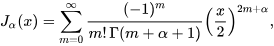
Then we will directly eliminate the terms including $J_1(0)$.

The final equation we will then calculate is:

$$
\frac{\partial^2 j}{\partial t^2} 
+ \frac{\eta D}{2}(\frac{\partial j}{\partial t} 
+ 2 s_0 e^{-s_0 t}) 
+ \frac{\eta D}{2} \cdot \frac{a}{t} J_1(at) \cdot (j - j_0(t))
= - \frac{D \gamma_0}{\epsilon} e^{-s_0 t}
$$


#### Residual of the PDE 

Substitute into the value of $s_0 = i \cdot s$ and $j_0 = 2 e^{-s_0 t}$, we obtain the real equation and the imaginary equation:

$$
\begin{cases}
\frac{\partial^2 j}{\partial t^2} + \frac{\eta D}{2} \cdot [\frac{\partial j}{\partial t} + 2s \sin(st) + \frac{a}{t} J_1(at) \cdot (j - 2 cos(st))] 
= - \frac{D \gamma_0}{\epsilon} \cos(st) \\
i \cdot \frac{\eta D}{2} \frac{a}{t} J_1(at) 2\sin(st) + i \cdot \frac{\eta D}{2} 2s \cos(st) = i\cdot \frac{D \gamma_0}{\epsilon}\sin(st)
\end{cases}
$$

$$
\Rightarrow
\begin{cases}
\frac{\partial^2 j}{\partial t^2} + \frac{\eta D}{2} \cdot [\frac{\partial j}{\partial t} + 2s \sin(st) + \frac{a}{t} J_1(at) \cdot (j - 2 cos(st))] 
= - \frac{D \gamma_0}{\epsilon} \cos(st) \\
\frac{\eta a}{t} J_1(at) \sin(st) + \eta s \cos(st) = \frac{\gamma_0}{\epsilon}\sin(st)
\end{cases}
$$


In [5]:
def real_residual(x, t, j, j_t, j_tt):    
    return j_tt + (eta * D / 2) * (j_t 
                                   + (a / t) * tf.math.special.bessel_j1(a * t) * (j - 2 * tf.cos(s * t))
                                   + 2 * s * tf.sin(s * t)) + (D * gamma / epsilon) * tf.cos(s * t)
    

#### Plot the Collocation Points

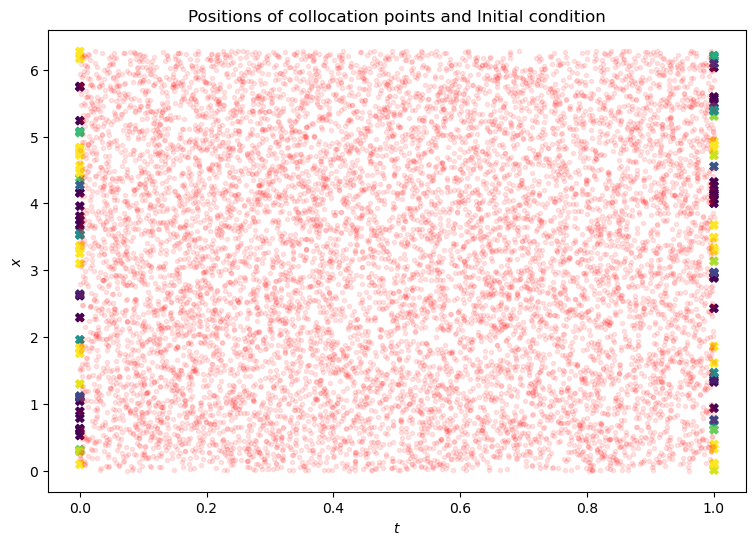

In [6]:
# Define the collocation points
t_r = tf.random.uniform((N_r,1), lb[0], jb[0], dtype=DTYPE)
x_r = tf.random.uniform((N_r,1), lb[1], jb[1], dtype=DTYPE)
X_r = tf.concat([t_r, x_r], axis=1)

# Plot the collocation points
fig = plt.figure(figsize=(9,6))
plt.scatter(t_0, x_0, c = j_initial_value, marker = 'X', vmin = -1, vmax = 1)
plt.scatter(t_N, x_N, c = j_end_value,     marker = 'X', vmin = -1, vmax = 1)
plt.scatter(t_r, x_r, c = 'r', marker = '.', alpha = 0.1)
plt.xlabel('$t$')
plt.ylabel('$x$')

plt.title('Positions of collocation points and Initial condition');
#plt.savefig('Xdata_Burgers.pdf', bbox_inches='tight', dpi=300)

In [7]:
def init_model(W = 4, H = 8, activation_function = 'tanh'):
    """
    W = num_hidden_layers     = 4 in default;
    H = num_neurons_per_layer = 8 in default;
    activation_function       = 'tanh' in default;
    """
    model = tf.keras.Sequential()
    model.add(tf.keras.Input(2))
    scaling_layer = tf.keras.layers.Lambda(
                lambda x: 2.0*(x - lb)/(jb - lb) - 1.0)
    model.add(scaling_layer)
    for _ in range(W):
        model.add(tf.keras.layers.Dense(H,
            activation = tf.keras.activations.get(activation_function),
            kernel_initializer = 'glorot_normal'))
    model.add(tf.keras.layers.Dense(1))
    return model

In [8]:
def get_r(model, X_r):
    with tf.GradientTape(persistent=True) as tape:
        t, x = X_r[:, 0:1], X_r[:, 1:2]
        tape.watch(t)
        tape.watch(x)
        j = model(tf.stack([t[:,0], x[:,0]], axis=1))
        j_t  = tape.gradient(j, t)
    j_tt = tape.gradient(j_t, t)
    del tape
    return real_residual(x, t, j, j_t, j_tt)

In [9]:
mse = tf.keras.losses.MeanSquaredError()

def compute_loss(model, X_r, X_boundary):
    r = get_r(model, X_r)
    loss_region  = mse(r, tf.zeros_like(r).numpy())
    loss_initial = mse(j_initial_value, model(X_boundary[0]))
    loss_end     = mse(j_end_value,     model(X_boundary[1]))
    loss         = loss_region + loss_initial + loss_end
    return loss


In [10]:
def get_grad(model, X_r, X_boundary):
    
    with tf.GradientTape(persistent = True) as tape:
        tape.watch(model.trainable_variables)
        loss = compute_loss(model, X_r, X_boundary)
    g = tape.gradient(loss, model.trainable_variables)
    del tape

    return loss, g

In [17]:
# Set up meshgrid
N_mesh = 500
tspace = np.linspace(lb[0], jb[0], N_mesh + 1)
xspace = np.linspace(lb[1], jb[1], N_mesh + 1)
T, X = np.meshgrid(tspace, xspace)
Xgrid = np.vstack([T.flatten(),X.flatten()]).T

def plot_NN(model, epochs):
    # Determine predictions of u(t, x)
    jpred  = model(tf.cast(Xgrid, DTYPE))
    j_NN   = jpred.numpy().reshape(N_mesh + 1, N_mesh + 1)    
    t_data = np.random.uniform(low = 0.0, high = 1.0, size = jpred.shape)

    # Real Surface plot of solution u(t,x)
    fig = plt.figure(figsize=(9,6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(X, T, j_NN, cmap='viridis')
    ax.set_xlabel('$x$')
    ax.set_ylabel('$t$')
    ax.set_zlabel('$j_\\theta(t,x)$')
    ax.set_title('NN Solution')
    ax.view_init(80, 0)
    plt.savefig(path + 'Real/NN sol_Real epoches = %s'%epochs, bbox_inches='tight', dpi=300)
    
    # Error plot for real solution
    def Exact_sol(x, t):
        return 2 * np.cos(xi * x - s * t)
    j_exact = Exact_sol(X, T)
    j_error = j_NN - j_exact
    fig = plt.figure(figsize=(9,6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(X, T, j_error, cmap='viridis')
    ax.set_xlabel('$x$')
    ax.set_ylabel('$t$')
    ax.set_zlabel('$j_\\theta(t,x)$')
    ax.set_title('NN Solution Errors (Real)')
    #ax.view_init(80, 0)
    plt.savefig(path + 'Errors/NN Error epoches = %s'%epochs, bbox_inches='tight', dpi=300)

    

Iteration 00000: Real loss = 1.01951675e+01
Iteration 00050: Real loss = 3.16461921e+00
Iteration 00100: Real loss = 3.09751701e+00
Iteration 00150: Real loss = 3.07703924e+00
Iteration 00200: Real loss = 3.06312132e+00
Iteration 00250: Real loss = 3.05054712e+00
Iteration 00300: Real loss = 3.01875281e+00
Iteration 00350: Real loss = 2.94717503e+00
Iteration 00400: Real loss = 2.78878641e+00
Iteration 00450: Real loss = 2.57441854e+00
Iteration 00500: Real loss = 2.30442762e+00


/var/folders/5j/937d92fj6mb3d4_kbhlhjrfr0000gn/T/ipykernel_42256/158619010.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(9,6))


Iteration 00550: Real loss = 1.89856517e+00
Iteration 00600: Real loss = 1.81890440e+00
Iteration 00650: Real loss = 1.75104296e+00
Iteration 00700: Real loss = 1.69264722e+00
Iteration 00750: Real loss = 1.63963532e+00
Iteration 00800: Real loss = 1.58843720e+00
Iteration 00850: Real loss = 1.53708458e+00
Iteration 00900: Real loss = 1.48499012e+00
Iteration 00950: Real loss = 1.43223488e+00
Iteration 01000: Real loss = 1.37906110e+00
Iteration 01050: Real loss = 1.35233378e+00
Iteration 01100: Real loss = 1.32557344e+00
Iteration 01150: Real loss = 1.29910088e+00
Iteration 01200: Real loss = 1.27294815e+00
Iteration 01250: Real loss = 1.24697614e+00
Iteration 01300: Real loss = 1.22095430e+00
Iteration 01350: Real loss = 1.19457054e+00
Iteration 01400: Real loss = 1.16743827e+00
Iteration 01450: Real loss = 1.13909018e+00
Iteration 01500: Real loss = 1.10889363e+00
Iteration 01550: Real loss = 1.07567072e+00
Iteration 01600: Real loss = 1.03660178e+00
Iteration 01650: Real loss = 9.8

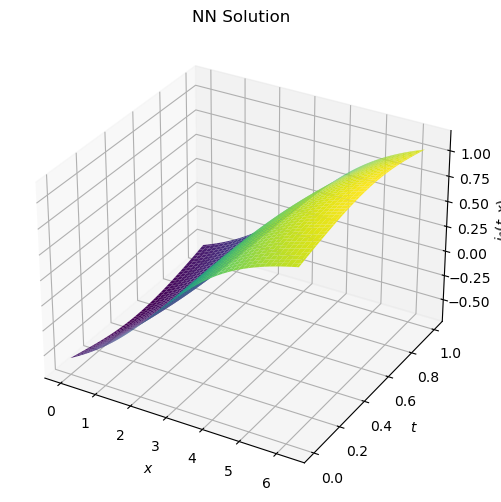

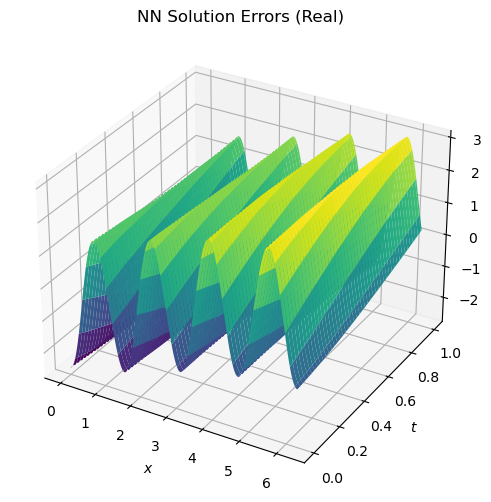

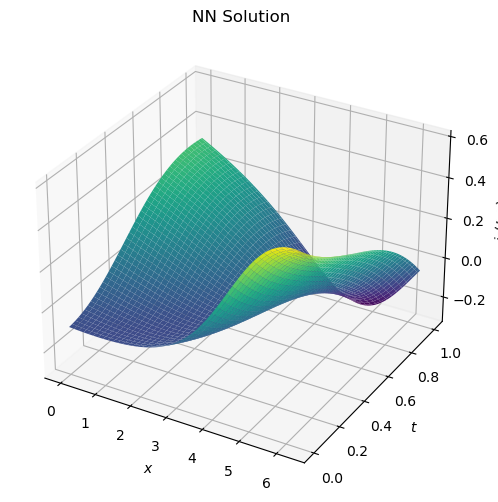

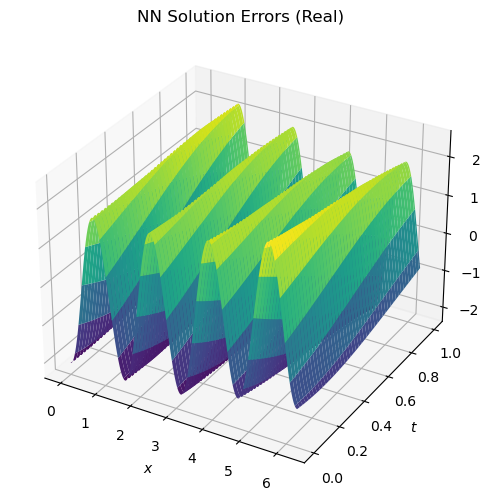

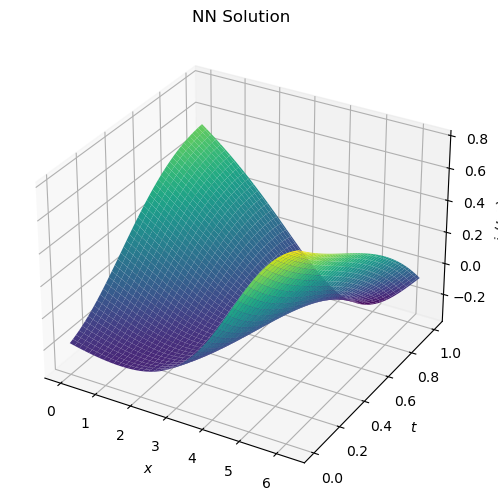

...

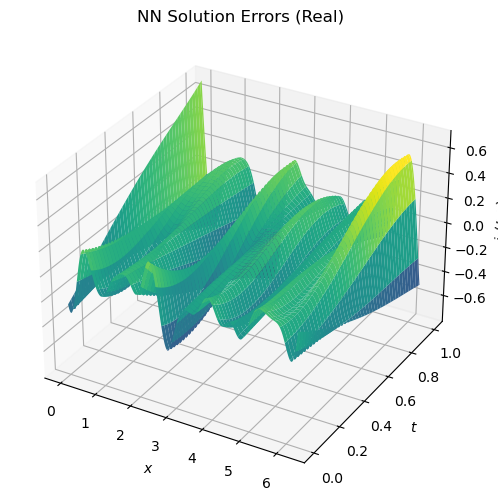

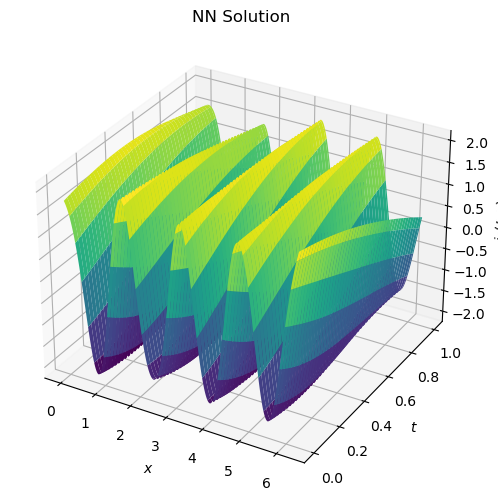

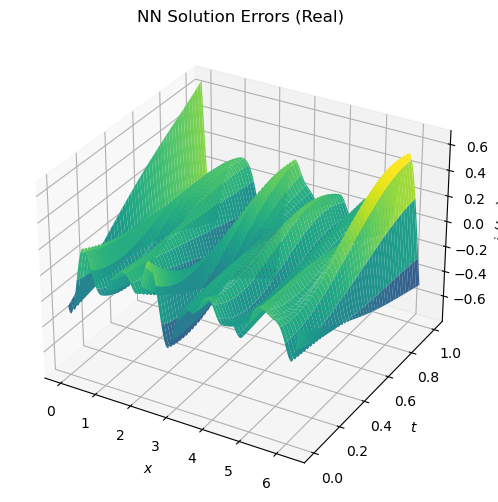

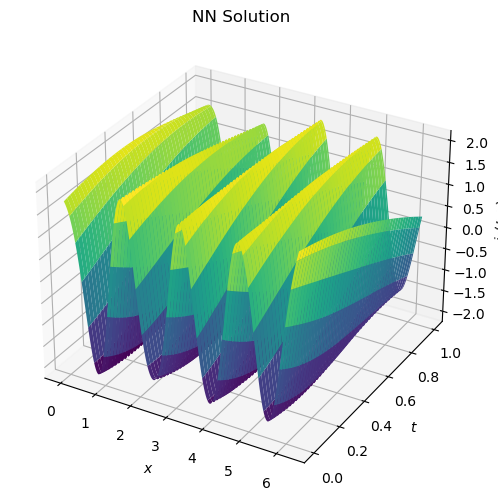

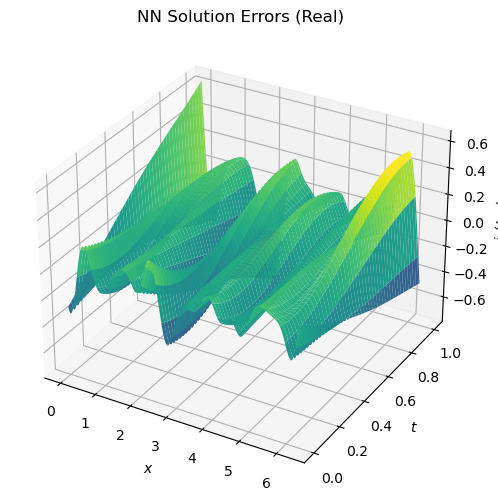

In [12]:
model = init_model(W = 4, H = 8, activation_function = 'tanh')
lr = tf.keras.optimizers.schedules.PiecewiseConstantDecay([1000, 2000], [1e-2,1e-3,5e-4])
optim = tf.keras.optimizers.Adam(learning_rate=lr)

from time import time
@tf.function
def train_step():
    loss, grad_theta = get_grad(model, X_r, X_boundary)
    optim.apply_gradients(zip(grad_theta, model.trainable_variables))
    return loss

epochs = 3000
hist   = []
t0     = time()

for i in range(epochs + 1):
    loss = train_step()
    loss, grad_theta = get_grad(model, X_r, X_boundary)
    optim.apply_gradients(zip(grad_theta, model.trainable_variables))
    hist.append(loss.numpy())
    if i%50 == 0:
        print('Iteration {:05d}: Real loss = {:10.8e}'.format(i, loss))
        plot_NN(model, i)
        
print('\nComputation time: {} seconds'.format(time() - t0))

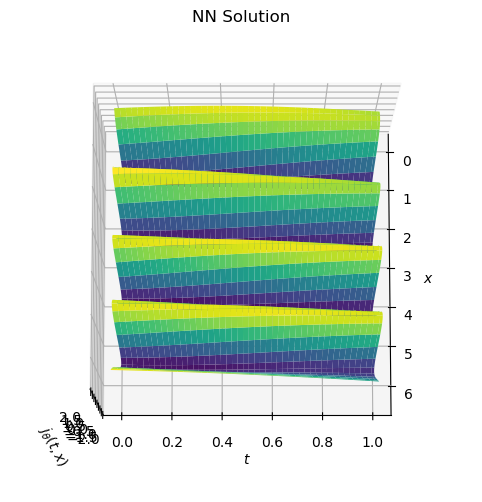

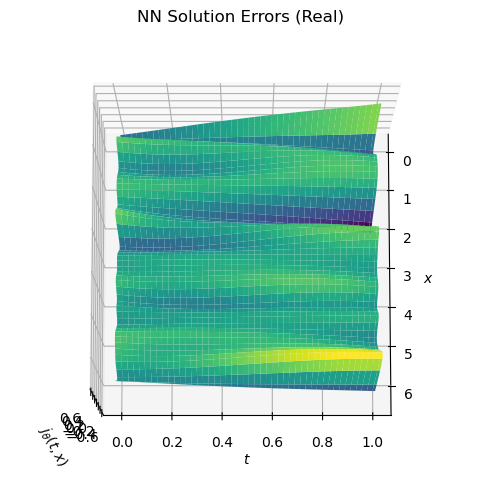

In [18]:
plot_NN(model, epochs)

### Plot solution

### Plot and Compare with the exact solution

$$
f(x, t) = 2 \cdot e^{i\xi x - s_0 t}
$$

$$
f(x, t) = 2 \cdot (\cos(\xi x - s t) + i \cdot \sin(\xi x - s t))
$$

$$
\Rightarrow f(x, 0) = 2 \cdot (\cos(\xi x) + i \cdot \sin(\xi x)) \\
\Rightarrow f(x, 1) = 2 \cdot (\cos(\xi x - s) + i \cdot \sin(\xi x - s))
$$

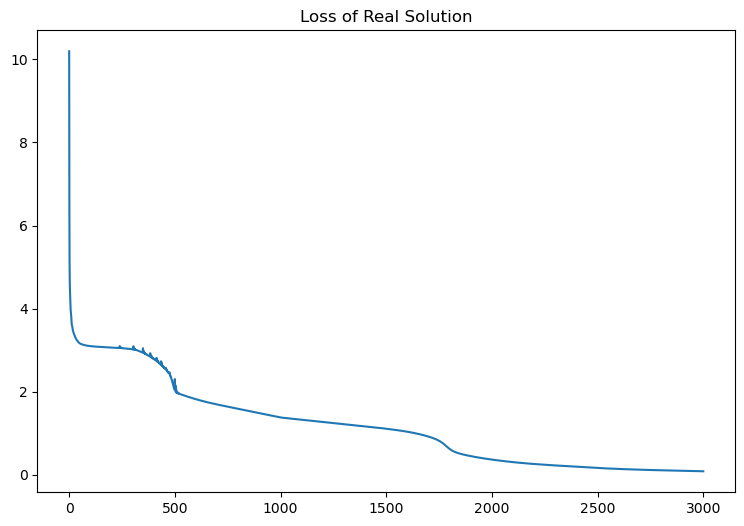

In [14]:
# Plot the losses of the output
L = len(hist)
epochs_axes = list(i for i in range(L))
fig = plt.figure(figsize=(9,6))
plt.plot(epochs_axes, hist)
plt.title('Loss of Real Solution')
plt.savefig(path + 'Loss of Solution')
plt.show()